<a href="https://colab.research.google.com/github/shevito/deeplearning-scikitlearn/blob/main/Practica_1_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
import numpy as np
from sklearn.datasets import fetch_california_housing
from sklearn.preprocessing import StandardScaler

# Cargar el conjunto de datos
housing = fetch_california_housing()
m, n = housing.data.shape

# Preparar los datos
housing_data_plus_bias = np.c_[np.ones((m, 1)), housing.data]
scaler = StandardScaler()
scaled_housing_data_plus_bias = scaler.fit_transform(housing_data_plus_bias)

X = tf.constant(scaled_housing_data_plus_bias, dtype=tf.float32)
y = tf.constant(housing.target.reshape(-1, 1), dtype=tf.float32)

# Usar la pseudoinversa en lugar de la inversa directa
XT = tf.transpose(X)
theta = tf.linalg.pinv(XT @ X) @ XT @ y

# Imprimir los valores de theta
print(theta.numpy())



[[ 0.        ]
 [ 0.8296205 ]
 [ 0.11875238]
 [-0.26552835]
 [ 0.30569738]
 [-0.00450317]
 [-0.03932621]
 [-0.8998809 ]
 [-0.8705362 ]]


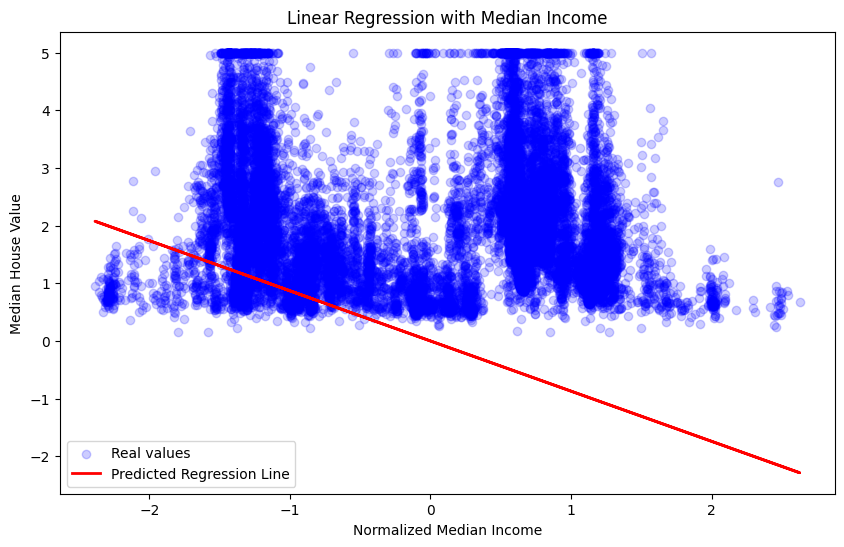

In [ ]:
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
from sklearn.datasets import fetch_california_housing
from sklearn.preprocessing import StandardScaler

# Cargar el conjunto de datos
housing = fetch_california_housing()
m, n = housing.data.shape

# Preparar los datos
housing_data_plus_bias = np.c_[np.ones((m, 1)), housing.data]
scaler = StandardScaler()
scaled_housing_data_plus_bias = scaler.fit_transform(housing_data_plus_bias)

X = tf.constant(scaled_housing_data_plus_bias, dtype=tf.float32)
y = tf.constant(housing.target.reshape(-1, 1), dtype=tf.float32)

# Usar la pseudoinversa en lugar de la inversa directa
XT = tf.transpose(X)
theta = tf.linalg.pinv(XT @ X) @ XT @ y

# Extraer los parámetros para la característica "median income" (normalizada)
# La posición de "median income" en los datos originales es 7 (el octavo atributo)
median_income_index = 7 + 1  # +1 por el sesgo
slope = theta[median_income_index].numpy()[0]
intercept = theta[0].numpy()[0]

# Preparar datos para la gráfica
x_median_income = scaled_housing_data_plus_bias[:, median_income_index]
y_predicted = slope * x_median_income + intercept

# Graficar
plt.figure(figsize=(10, 6))
plt.scatter(x_median_income, housing.target, alpha=0.2, c='blue', label='Real values')
plt.plot(x_median_income, y_predicted, 'r-', linewidth=2, label='Predicted Regression Line')
plt.xlabel('Normalized Median Income')
plt.ylabel('Median House Value')
plt.title('Linear Regression with Median Income')
plt.legend()
plt.show()


La concentración de puntos y la línea de regresión sugieren una tendencia: a medida que aumenta el ingreso medio normalizado, también lo hace el valor medio de la vivienda hasta cierto punto. Sin embargo, también se puede observar que hay una considerable variación en los precios de las viviendas que no se explican únicamente por el ingreso medio. Esto es común en los datos del mundo real, donde otras variables no representadas en este gráfico de una sola dimensión también afectan el valor de la vivienda.

Además, parece que hay valores atípicos o un límite superior en el valor de las viviendas, ya que hay una concentración horizontal de puntos en la parte superior del gráfico. Esto podría deberse a un recorte en los precios de las viviendas en el conjunto de datos o a un límite en los precios del mercado cuando se recopiló el conjunto de datos.

In [ ]:
# Importar TensorFlow y otras bibliotecas necesarias
import tensorflow as tf
import numpy as np
import datetime
from sklearn.datasets import fetch_california_housing
from sklearn.preprocessing import StandardScaler

# Cargar el conjunto de datos de viviendas de California
housing = fetch_california_housing()

# Preparar los datos
scaler = StandardScaler()
scaled_housing_data = scaler.fit_transform(housing.data)

# Crear un log directorio para TensorBoard
logdir = "logs/histograms/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
writer = tf.summary.create_file_writer(logdir)

# Registrar los histogramas
with writer.as_default():
    for i, feature_name in enumerate(housing.feature_names):
        tf.summary.histogram(feature_name, scaled_housing_data[:, i], step=0)
    writer.flush()

# Iniciar TensorBoard
%load_ext tensorboard
%tensorboard --logdir logs/histograms


<IPython.core.display.Javascript object>

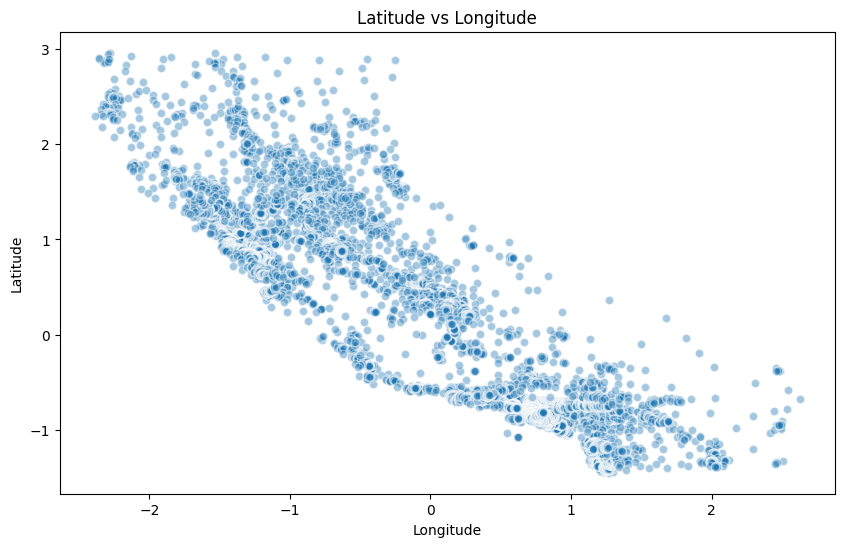

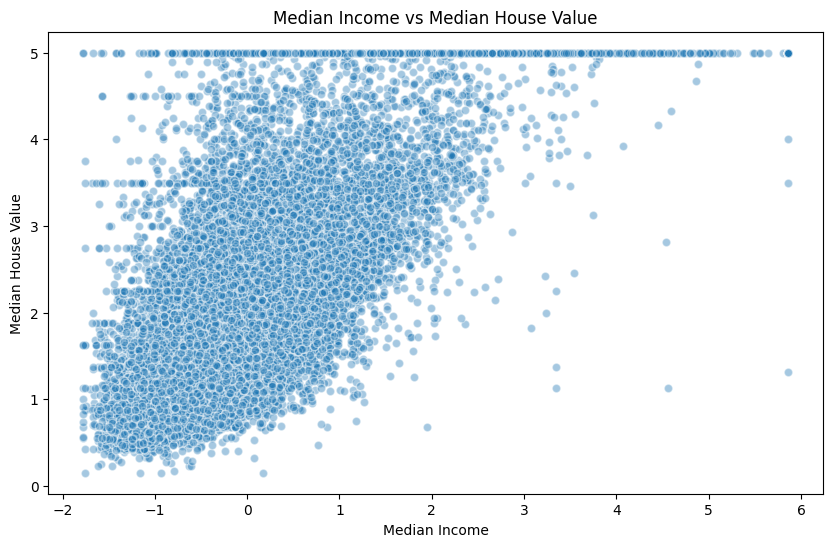

In [ ]:
import matplotlib.pyplot as plt
from sklearn.datasets import fetch_california_housing
from sklearn.preprocessing import StandardScaler

# Cargar el conjunto de datos de viviendas de California
housing = fetch_california_housing()

# Escalar las características para una mejor visualización
scaler = StandardScaler()
housing_data_scaled = scaler.fit_transform(housing.data)

# Las características en el conjunto de datos
features = housing.feature_names

# Función para crear diagramas de dispersión
def plot_scatter(x, y, x_label, y_label, title):
    plt.figure(figsize=(10, 6))
    plt.scatter(x, y, alpha=0.4, edgecolor='w')
    plt.title(title)
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    plt.show()

# Crear los diagramas de dispersión para cada combinación especificada
# a. Latitude vs longitude
plot_scatter(housing_data_scaled[:, features.index('Longitude')],
             housing_data_scaled[:, features.index('Latitude')],
             'Longitude', 'Latitude', 'Latitude vs Longitude')

# b. Median income vs median house value
plot_scatter(housing_data_scaled[:, features.index('MedInc')],
             housing.target,
             'Median Income', 'Median House Value', 'Median Income vs Median House Value')

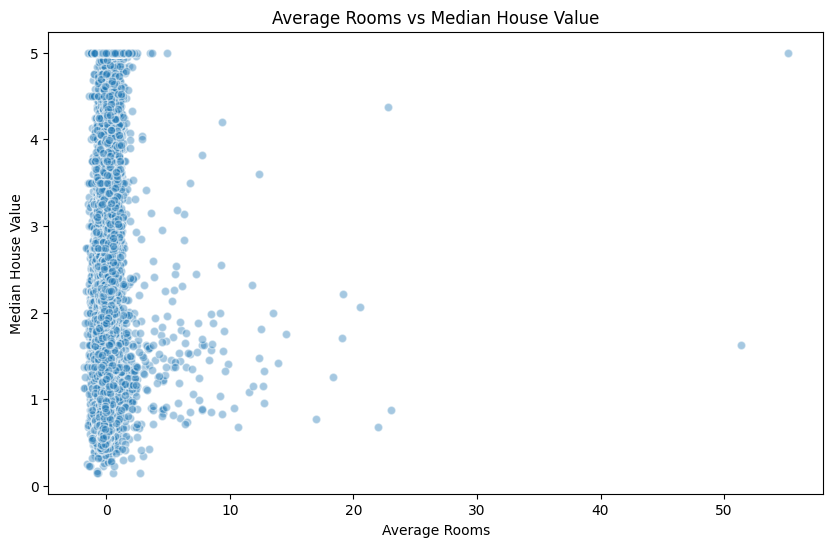

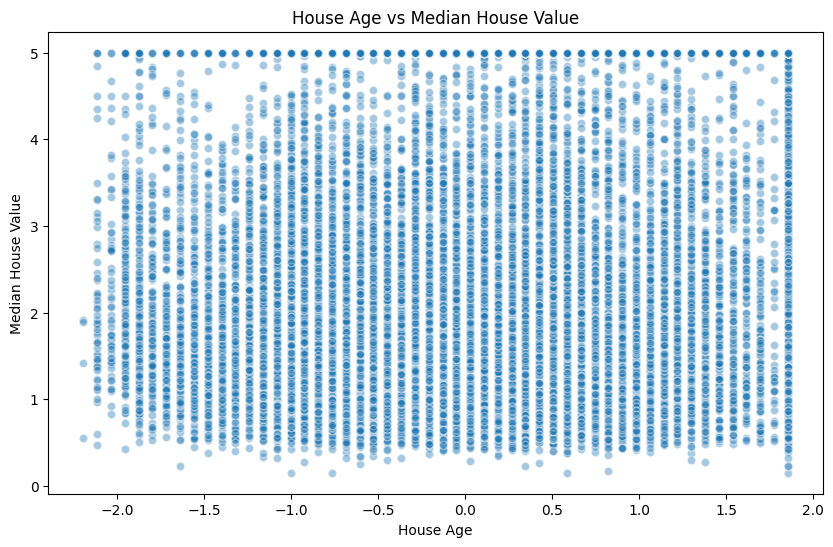

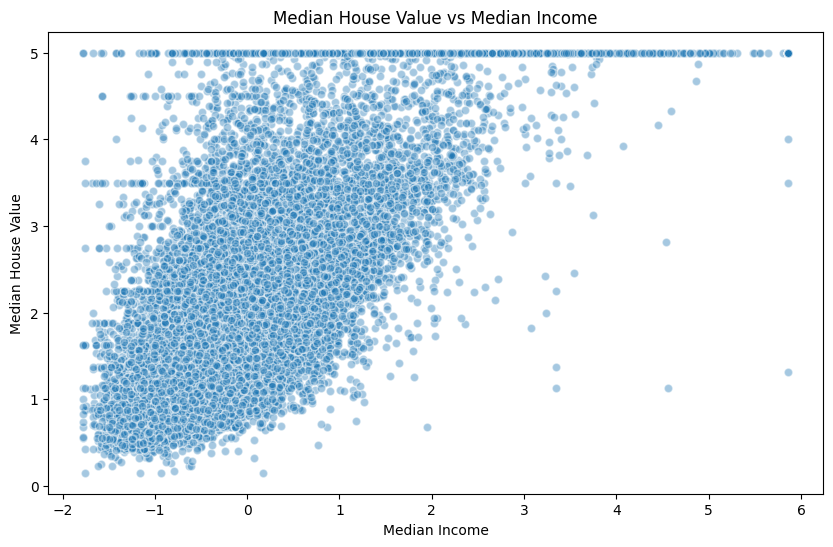

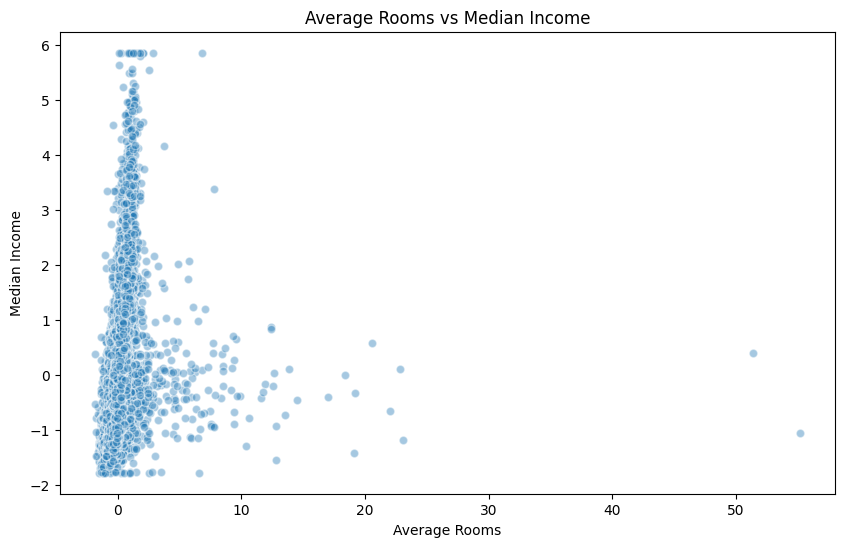

In [ ]:
# c. Average rooms vs median house value
plot_scatter(housing_data_scaled[:, features.index('AveRooms')],
             housing.target,
             'Average Rooms', 'Median House Value', 'Average Rooms vs Median House Value')

# d. House age vs median house value
plot_scatter(housing_data_scaled[:, features.index('HouseAge')],
             housing.target,
             'House Age', 'Median House Value', 'House Age vs Median House Value')

# e. Median house value vs median income
plot_scatter(housing_data_scaled[:, features.index('MedInc')],
             housing.target,
             'Median Income', 'Median House Value', 'Median House Value vs Median Income')

# f. Average rooms vs median income
plot_scatter(housing_data_scaled[:, features.index('AveRooms')],
             housing_data_scaled[:, features.index('MedInc')],
             'Average Rooms', 'Median Income', 'Average Rooms vs Median Income')

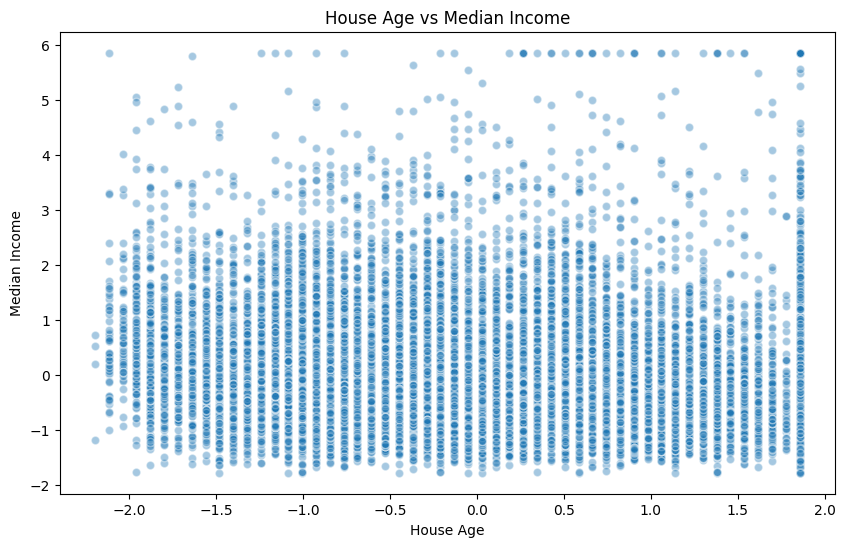

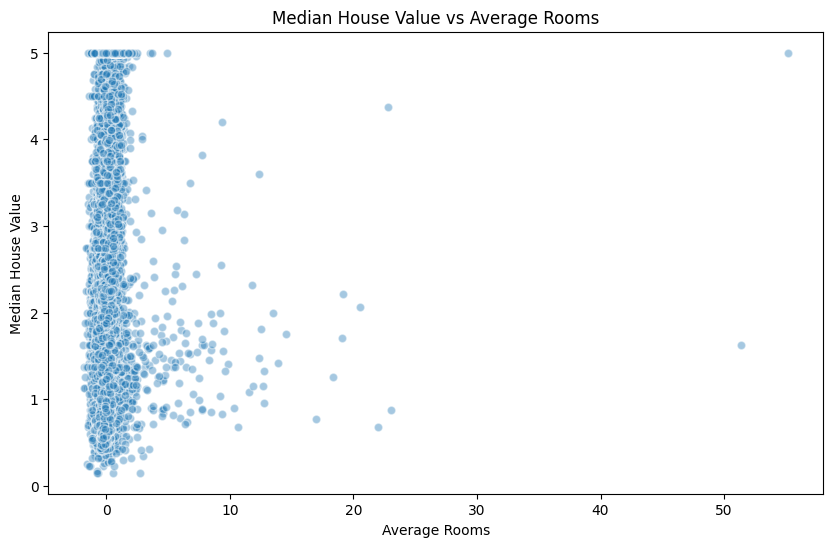

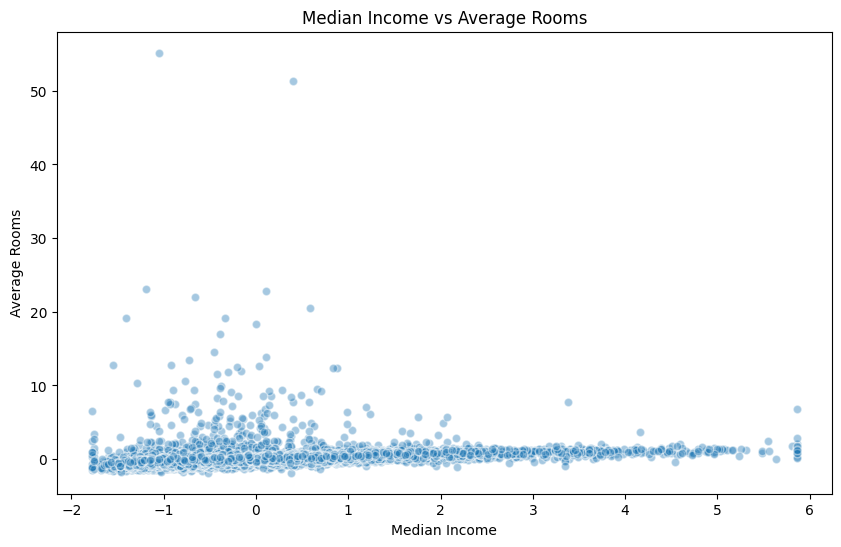

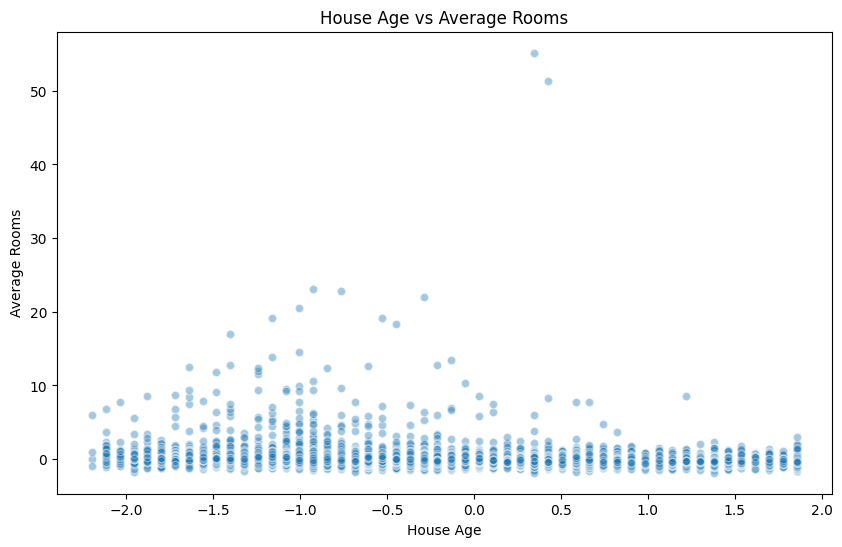

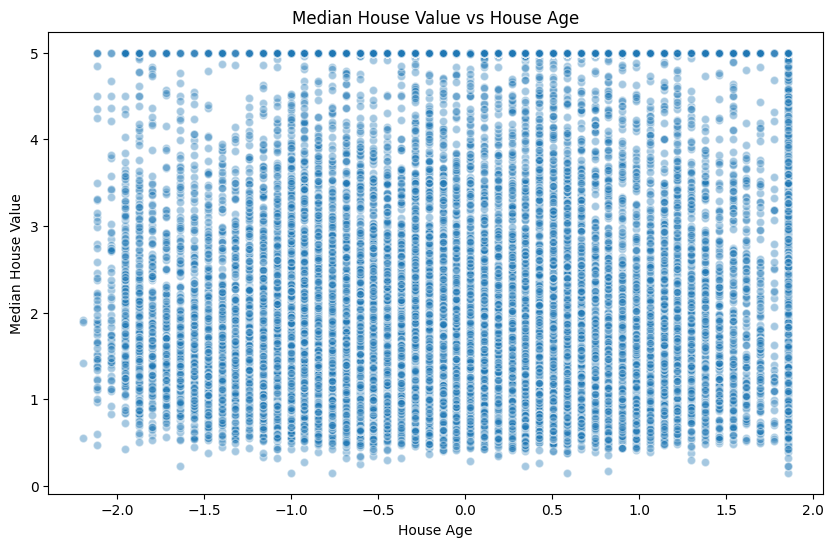

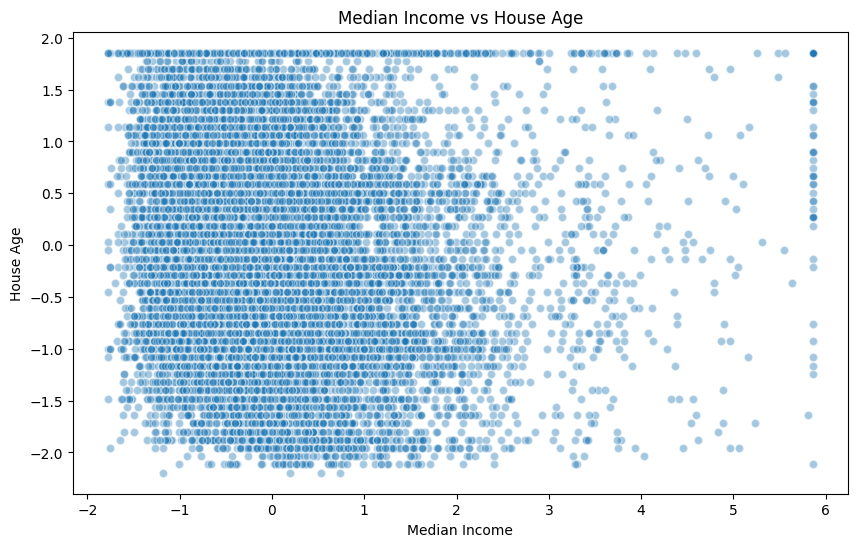

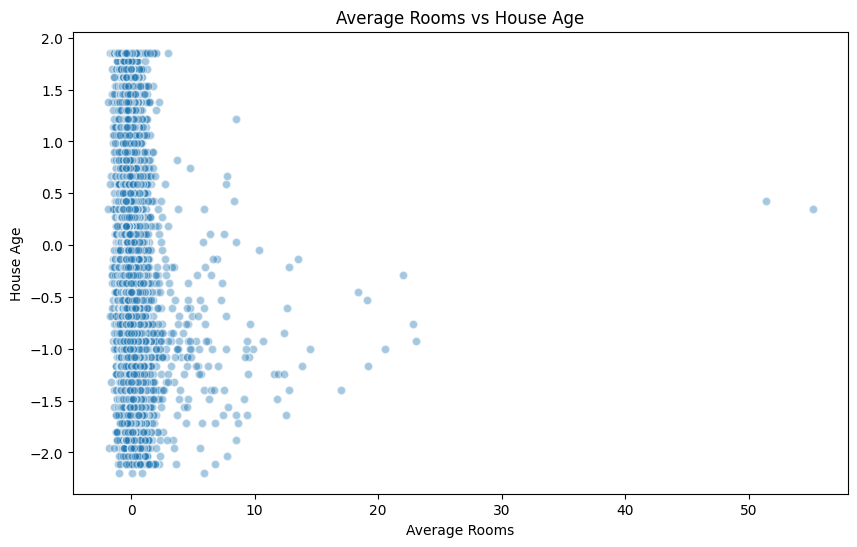

In [ ]:
# g. House age vs median income
plot_scatter(housing_data_scaled[:, features.index('HouseAge')],
             housing_data_scaled[:, features.index('MedInc')],
             'House Age', 'Median Income', 'House Age vs Median Income')

# h. Median house value vs average rooms
plot_scatter(housing_data_scaled[:, features.index('AveRooms')],
             housing.target,
             'Average Rooms', 'Median House Value', 'Median House Value vs Average Rooms')

# i. Median income vs average rooms
plot_scatter(housing_data_scaled[:, features.index('MedInc')],
             housing_data_scaled[:, features.index('AveRooms')],
             'Median Income', 'Average Rooms', 'Median Income vs Average Rooms')

# j. House age vs average rooms
plot_scatter(housing_data_scaled[:, features.index('HouseAge')],
             housing_data_scaled[:, features.index('AveRooms')],
             'House Age', 'Average Rooms', 'House Age vs Average Rooms')

# k. Median house value vs house age
plot_scatter(housing_data_scaled[:, features.index('HouseAge')],
             housing.target,
             'House Age', 'Median House Value', 'Median House Value vs House Age')

# l. Median income vs house age
plot_scatter(housing_data_scaled[:, features.index('MedInc')],
             housing_data_scaled[:, features.index('HouseAge')],
             'Median Income', 'House Age', 'Median Income vs House Age')

# m. Average rooms vs house age
plot_scatter(housing_data_scaled[:, features.index('AveRooms')],
             housing_data_scaled[:, features.index('HouseAge')],
             'Average Rooms', 'House Age', 'Average Rooms vs House Age')

In [ ]:
import matplotlib.pyplot as plt
import tensorflow as tf
import io

# Función para convertir una figura de Matplotlib a una imagen de TensorBoard
def plot_to_image(figure):
    """Convierte una figura de Matplotlib a una imagen de PNG."""
    buf = io.BytesIO()
    plt.savefig(buf, format='png')
    plt.close(figure)
    buf.seek(0)
    image = tf.image.decode_png(buf.getvalue(), channels=4)
    image = tf.expand_dims(image, 0)
    return image

# Ejemplo de cómo generar una figura y convertirla a una imagen de TensorBoard
def log_scatter_plot(feature_x, feature_y, x_label, y_label, title, log_dir, step):
    figure = plt.figure(figsize=(10, 6))
    plt.scatter(feature_x, feature_y, alpha=0.4, edgecolor='w')
    plt.title(title)
    plt.xlabel(x_label)
    plt.ylabel(y_label)

    # Convertir la figura a una imagen de TensorBoard
    image = plot_to_image(figure)

    # Crear un escritor de resúmenes para escribir en el disco
    writer = tf.summary.create_file_writer(log_dir)

    # Registrar la imagen en TensorBoard
    with writer.as_default():
        tf.summary.image(title, image, step=step)

# Especifica el directorio donde deseas guardar los registros de TensorBoard
log_dir = 'logs/scatter_plots'

# Llamar a `log_scatter_plot` para cada combinación de características que desees registrar, por ejemplo:
log_scatter_plot(feature_x=housing_data_scaled[:, features.index('AveRooms')],
                 feature_y=housing.target,
                 x_label='Average Rooms',
                 y_label='Median House Value',
                 title='Average Rooms vs Median House Value',
                 log_dir=log_dir,
                 step=0)


In [ ]:
%load_ext tensorboard
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import io
from sklearn.datasets import fetch_california_housing
from sklearn.preprocessing import StandardScaler

# Cargar y preparar los datos
housing = fetch_california_housing()
scaler = StandardScaler()
housing_data_scaled = scaler.fit_transform(housing.data)
features = housing.feature_names

# Función para convertir una figura de Matplotlib en una imagen para TensorBoard
def plot_to_image(figure):
    buf = io.BytesIO()
    plt.savefig(buf, format='png')
    plt.close(figure)
    buf.seek(0)
    image = tf.image.decode_png(buf.getvalue(), channels=4)
    image = tf.expand_dims(image, 0)
    return image

# Función para generar y loguear un diagrama de dispersión
def log_scatter_plot(feature_x, feature_y, x_label, y_label, title, writer, step):
    figure = plt.figure(figsize=(10, 6))
    plt.scatter(feature_x, feature_y, alpha=0.4, edgecolor='w')
    plt.title(title)
    plt.xlabel(x_label)
    plt.ylabel(y_label)
    image = plot_to_image(figure)

    # Loguear la imagen en TensorBoard
    with writer.as_default():
        tf.summary.image(title, image, step=step)

# Iniciar TensorBoard dentro de Google Colab
log_dir = '/content/logs/scatter_plots'
writer = tf.summary.create_file_writer(log_dir)

# Generar y loguear un diagrama de dispersión
log_scatter_plot(housing_data_scaled[:, features.index('AveRooms')],
                 housing.target,
                 'Average Rooms',
                 'Median House Value',
                 'Average Rooms vs Median House Value',
                 writer,
                 step=0)

# Visualizar TensorBoard dentro de Colab
%tensorboard --logdir /content/logs/scatter_plots



<IPython.core.display.Javascript object>

In [ ]:
%reload_ext tensorboard
import tensorflow as tf
import matplotlib.pyplot as plt
import io
from sklearn.datasets import fetch_california_housing
from sklearn.preprocessing import StandardScaler

# Cargar el conjunto de datos de viviendas de California
housing = fetch_california_housing()
X = housing.data
y = housing.target
features = housing.feature_names

# Escalar las características para una mejor visualización
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Directorio para los logs de TensorBoard
log_dir = '/content/logs/scatter_plots'
writer = tf.summary.create_file_writer(log_dir)


In [11]:
# Funciones plot_to_image y log_scatter_plot como se definió previamente

# Lista de combinaciones (a - m)
combinations = [
    ('Latitude', 'Longitude', 'Latitude vs Longitude'),
    ('MedInc', 'Median House Value', 'Median Income vs Median House Value'),
    ('AveRooms', 'Median House Value', 'Average Rooms vs Median House Value'),
    ('HouseAge', 'Median House Value', 'House Age vs Median House Value'),
    ('Median House Value', 'MedInc', 'Median House Value vs Median Income'),
    ('AveRooms', 'MedInc', 'Average Rooms vs Median Income'),
    ('HouseAge', 'MedInc', 'House Age vs Median Income'),
    ('Median House Value', 'AveRooms', 'Median House Value vs Average Rooms'),
    ('MedInc', 'AveRooms', 'Median Income vs Average Rooms'),
    ('HouseAge', 'AveRooms', 'House Age vs Average Rooms'),
    ('Median House Value', 'HouseAge', 'Median House Value vs House Age'),
    ('MedInc', 'HouseAge', 'Median Income vs House Age'),
    ('AveRooms', 'HouseAge', 'Average Rooms vs House Age')
]

# Función para extraer las características por nombre
def get_feature(name):
    if name in ['Median House Value', 'Median Income']:
        return y if name == 'Median House Value' else X_scaled[:, features.index('MedInc')]
    return X_scaled[:, features.index(name)]

# Generar y loguear los gráficos para cada combinación
for feature_x_name, feature_y_name, title in combinations:
    feature_x = get_feature(feature_x_name)
    feature_y = get_feature(feature_y_name)
    log_scatter_plot(feature_x, feature_y,
                     feature_x_name, feature_y_name,
                     title, writer, step=0)

# Iniciar TensorBoard
%tensorboard --logdir /content/logs/scatter_plots


Reusing TensorBoard on port 6006 (pid 3095), started 0:07:08 ago. (Use '!kill 3095' to kill it.)

<IPython.core.display.Javascript object>